The following script was written by Christian Mateo Benitez Rojas.

*Brain MRI segmentation IA with YOLO neuronal network.*

The database was obtained by: [Brain MRI segmentation](https://www.kaggle.com/datasets/mateuszbuda/lgg-mri-segmentation)


In [ ]:
!pip install ultralytics

import ultralytics
ultralytics.checks()

In [98]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import cv2
import os
from tqdm import tqdm
from ultralytics import YOLO

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Collecting all image from dir.
path = '/content/drive/MyDrive/my_colabs/kaggle_3m/'

data_map = []
xrays_of_people_dir = os.listdir(path)
for patients_dir in xrays_of_people_dir:
    patient_xrays_dir = os.listdir(path+patients_dir)
    for xray in patient_xrays_dir:
        xray_path = path+patients_dir+'/'+xray
        data_map.extend([patients_dir, xray_path])
        # plt.imshow(cv2.imread(xray_path, 0), cmap='gray')

In [4]:
# Collecting dir name = patiente and the image paths.
db = pd.DataFrame({
    'dir': data_map[0::2],
    'path': data_map[1::2]
})

In [5]:
# Creating a new database with sorted data.
n_patients = 24
sorted_db = pd.DataFrame(columns=['patient', 'brain', 'mask'])
for n in range(n_patients):

    patient_images = db[db['dir'] == f'patient{n+1}']['path']
    sorted_paths = sorted(patient_images, key= lambda filename: int(filename.split('/')[-1].split('.')[0]))
    brain_images = sorted_paths[0::2]
    mask_images = sorted_paths[1::2]

    sorted_db = pd.concat([sorted_db, pd.DataFrame({'patient': f'patient{n+1}', 'brain': brain_images, 'mask': mask_images})])

In [ ]:
# Transform the mask images to a yolo format label.

input_dir = '/content/drive/MyDrive/my_colabs/tmp/masks'
output_dir = '/content/drive/MyDrive/my_colabs/tmp/labels'

for j in tqdm(os.listdir(input_dir)):
    image_path = os.path.join(input_dir, j)
    # load the binary mask and get its contours
    mask = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    _, mask = cv2.threshold(mask, 1, 255, cv2.THRESH_BINARY)

    H, W = mask.shape
    contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # convert the contours to polygons
    polygons = []
    for cnt in contours:
        if cv2.contourArea(cnt) > 200:
            polygon = []
            for point in cnt:
                x, y = point[0]
                polygon.append(x / W)
                polygon.append(y / H)
            polygons.append(polygon)

    # print the polygons
    with open('{}.txt'.format(os.path.join(output_dir, j)[:-4]), 'w') as f:
        for polygon in polygons:
            for p_, p in enumerate(polygon):
                if p_ == len(polygon) - 1:
                    f.write('{}\n'.format(p))
                elif p_ == 0:
                    f.write('0 {} '.format(p))
                else:
                    f.write('{} '.format(p))

        f.close()

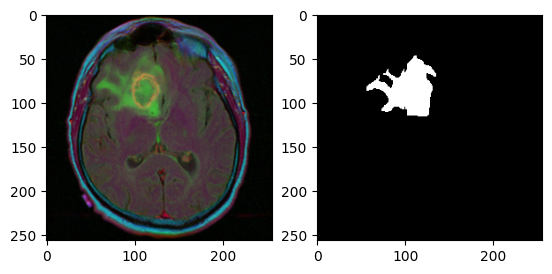

In [37]:
index = 12
fig, axes = plt.subplots(1, 2)
axes[0].imshow(cv2.imread(sorted_db['brain'].iloc[index]))
axes[1].imshow(cv2.imread(sorted_db['mask'].iloc[index]))

In [61]:
train_dir_brains = sorted(os.listdir('/content/drive/MyDrive/my_colabs/data/images/train'), key= lambda x: int(x.split('/')[-1].split('.')[0]))
train_dirs_labels = sorted(os.listdir('/content/drive/MyDrive/my_colabs/data/labels/train'), key= lambda x: int(x.split('/')[-1].split('.')[0]))

In [64]:
db2 = pd.DataFrame({
    'brains': train_dir_brains,
    'labels': train_dirs_labels
})

Training YOLO

In [ ]:
model = YOLO('yolov8l-seg.pt')
model.train(data='/content/drive/MyDrive/my_colabs/data/config.yaml', epochs=20, imgsz=256)

Using the model in a patient.

In [57]:
model = YOLO('/content/drive/MyDrive/my_colabs/train4/weights/last.pt')

In [47]:
def patient_dir_to_numpy_list(folder_dir):
  sorted_images = sorted(os.listdir(folder_dir), key=lambda file: int(file.split('_')[4].split('.')[0]))
  images = []
  for image_dir in sorted_images:
    if not('mask' in image_dir):
      images.append(cv2.imread(folder_dir+image_dir))
  return np.asarray(images, dtype=np.uint8)

In [119]:
person_dir = '/content/drive/MyDrive/my_colabs/data/TCGA_FG_A4MT_20020212/'
output_dir = '/content/drive/MyDrive/my_colabs/results/'

all_images = patient_dir_to_numpy_list(person_dir)

In [ ]:
len = all_images.shape[0]
masks = []
for index, image in enumerate(all_images):
  print(f'Image {index}')
  results = model(image)
  for result in results:
    if result.masks != None:
      for id, mask in enumerate(result.masks.data):
        mask = mask.numpy() * 255
        mask = cv2.resize(mask, (256, 256))
        masks.append(mask)
        cv2.imwrite(f'{output_dir}brain{index}_{id}.png', mask)
    else:
      empty_image = np.zeros((256, 256), dtype=np.uint8)
      masks.append(empty_image)
      cv2.imwrite(f'{output_dir}brain{index}_{id}.png', empty_image)

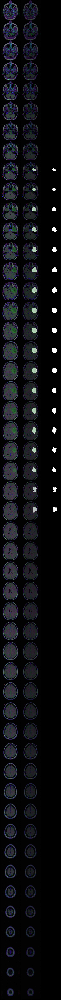

In [201]:
opacity = 0.6
fig, axes = plt.subplots(len, 3, figsize=(15, len*5))
fig.subplots_adjust(wspace=0, hspace=0)
fig.set_facecolor('black')

for index in range(len):
  brain_with_mask = cv2.addWeighted(
      all_images[index].astype('uint8'),
      opacity,
      cv2.cvtColor(masks[index], cv2.COLOR_GRAY2RGB).astype('uint8'),
      opacity,
      0)
  brain_with_mask = cv2.cvtColor(brain_with_mask, cv2.COLOR_BGR2RGB)

  axes[index][0].imshow(cv2.cvtColor(all_images[index], cv2.COLOR_BGR2RGB))
  axes[index][0].axis('off')
  axes[index][1].imshow(brain_with_mask, cmap='gray')
  axes[index][1].axis('off')
  axes[index][2].imshow(masks[index], cmap='gray')
  axes[index][2].axis('off')


plt.savefig(f'{output_dir}result.png')
plt.show()

# With another neuronal networks.

In [48]:
from skimage.transform import resize
from tqdm import tqdm

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, Lambda

In [ ]:
height_shape, width_shape = 256, 256

Transform the dir to a np.arrays

In [ ]:
x = []
for brain in tqdm(sorted_db['brain']):
  x.append(cv2.imread(brain))
x = np.asarray(x, dtype=np.uint8)

100%|██████████| 677/677 [00:01<00:00, 446.63it/s]


In [ ]:
y = []
# Creamos una mascarar de zeros
for mask in tqdm(sorted_db['mask']):
  y.append(resize(cv2.imread(mask), (height_shape, width_shape, 1), mode='constant', preserve_range=True))
y = np.asarray(y, dtype=np.uint8)

100%|██████████| 677/677 [00:06<00:00, 97.51it/s]


In [ ]:
print(x.shape, y.shape)

(677, 256, 256, 3) (677, 128, 128, 1)


In [ ]:
# Definimos la entrada al modelo
Image_input = Input((height_shape, width_shape, 3))
Image_in = Lambda(lambda x: x / 255)(Image_input)

#contracting path
conv1 = Conv2D(64, (3, 3), activation='relu', padding='same')(Image_in)
conv1 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv1)
maxp1 = MaxPooling2D((2, 2))(conv1)

conv2 = Conv2D(128, (3, 3), activation='relu', padding='same')(maxp1)
conv2 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv2)
maxp2 = MaxPooling2D((2, 2))(conv2)

conv3 = Conv2D(256, (3, 3), activation='relu', padding='same')(maxp2)
conv3 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv3)
maxp3 = MaxPooling2D((2, 2))(conv3)

conv4 = Conv2D(512, (3, 3), activation='relu', padding='same')(maxp3)
conv4 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv4)
maxp4 = MaxPooling2D(pool_size=(2, 2))(conv4)

conv5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(maxp4)
conv5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(conv5)

#expansive path
up6 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(conv5)
up6 = concatenate([up6, conv4])
conv6 = Conv2D(512, (3, 3), activation='relu', padding='same')(up6)
conv6 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv6)

up7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv6)
up7 = concatenate([up7, conv3])
conv7 = Conv2D(256, (3, 3), activation='relu', padding='same')(up7)
conv7 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv7)

up8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv7)
up8 = concatenate([up8, conv2])
conv8 = Conv2D(128, (3, 3), activation='relu', padding='same')(up8)
conv8 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv8)

up9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv8)
up9 = concatenate([up9, conv1], axis=3)
conv9 = Conv2D(64, (3, 3), activation='relu', padding='same')(up9)
conv9 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv9)

outputs = Conv2D(1, (1, 1), activation='sigmoid')(conv9)

model = Model(inputs=[Image_input], outputs=[outputs])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
# model.summary()

In [ ]:
batch_size = 16
epochs = 5

results = model.fit(x, y, validation_split=0.1, batch_size=batch_size, epochs=epochs, verbose=True)

In [ ]:
# Definir la arquitectura de la red neuronal
def create_segmentation_model():
    inputs = Input(shape=(256, 256, 3))

    # Capa de convolución
    conv1 = Conv2D(32, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(32, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    # Capa de desconvolución
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(conv2)
    up1 = Conv2DTranspose(32, 2, strides=(2, 2), padding='same')(conv2)

    # Capa de salida
    output = Conv2D(1, 1, activation='sigmoid')(up1)

    model = Model(inputs=inputs, outputs=output)
    return model

# Crear el modelo
model = create_segmentation_model()

# Compilar el modelo
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Imprimir el resumen del modelo
model.summary()


In [ ]:
results = model.fit(x, y, validation_split=0.1, batch_size=16, epochs=60, verbose=True)

In [ ]:
result = model.predict(x[0:12])

1/1 [==============================] - 2s 2s/step
